In [6]:
import os
### QAOA_realestate가 있는 폴더로 지정
dir_path = "/Users/minhyeong-gyu/Documents/GitHub/QuantumVariableSelection"
os.chdir(dir_path)
import sys
module_path = dir_path + "/Module"
if module_path not in sys.path:
    sys.path.append(module_path)

from optimizer import optimizer as opt
from optimizer import basefunctions as bf

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
from matplotlib import font_manager, rc
# 윈도우 한글 폰트
# font_path = "C:/Windows/Fonts/NGULIM.TTF"
# font = font_manager.FontProperties(fname=font_path).get_name()
# rc('font', family=font)

# Mac 한글 폰트
rc('font', family='AppleGothic')
plt.rcParams['axes.unicode_minus'] = False

import seaborn as sns
from dwave.system import LeapHybridCQMSampler
%matplotlib inline

In [7]:
def trim_down(x):
    x= np.asarray(x)
    result = [0.0 if i < 0.0 else i for i in x]
    return result

def trim_up(x):
    x= np.asarray(x)
    result = [1.0 if i > 1.0 else i for i in x]
    return result

def trim(x):
    result = trim_up(trim_down(x))
    return result

In [8]:
from sklearn.utils import check_random_state

In [9]:
# def generate_dependent_sample_logistic(n_samples=500, n_features=10, beta_coef =[4,3,2,2],epsilon=4,covariance_parameter=1, random_state=None):
#     rng = check_random_state(random_state)
#     if n_features < 4:
#         raise ValueError("`n_features` must be >= 4. "
#                             "Got n_features={0}".format(n_features))
#     v = rng.normal(0, 0.4, (n_features, n_features))
#     mean = np.zeros(n_features)
#     cov = v @ v.T*covariance_parameter + 0.1 * np.identity(n_features)
#     X = rng.multivariate_normal(mean, cov, n_samples)
#     n_informative = len(beta_coef)
#     beta = np.hstack((
#         beta_coef, np.zeros(n_features - n_informative)))
#     theta = np.dot(X, beta)
#     theta += -1*np.mean(theta)
#     theta += epsilon * rng.randn(n_samples)
#     prob = (1+np.exp(20*theta/np.max(theta)))**(-1)
#     y = np.array([(np.random.rand()<i)*1.0 for i in prob]).reshape((n_samples,))
#     return X, y

In [10]:
sa_mi_heatmap = []
sa_full_heatmap = []
sa_partial_heatmap = []

for i in range(10):
    n_features=8
    number_influentials = 8
    number_features = 40
    number_samples = 2000
    covariance_parameter = 100
    lmbd = 0.005
    beta_coef = np.concatenate([np.random.normal(10,1,number_influentials),np.zeros(number_features-number_influentials)])
    epsilon = 0
    X,y = bf.generate_dependent_sample_logistic(number_samples,number_features,beta_coef,covariance_parameter=covariance_parameter,epsilon=epsilon)
    y_type="binary"
    sa_mi = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="mi")
    sa_mi_result = sa_mi.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_full = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="full")
    sa_full_result = sa_full.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_partial = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="partial")
    sa_partial_result = sa_partial.optimize(X,y,lmbd,reps=10,n_features=n_features)
    
    sa_mi_heatmap += [sa_mi_result.tolist()]
    sa_full_heatmap += [sa_full_result.tolist()]
    sa_partial_heatmap += [sa_partial_result.tolist()]

KeyboardInterrupt: 

In [ ]:
number_influentials = 8
number_features = 40
number_samples = 2000
covariance_parameter = 100
lmbd = 0.005
beta_coef = np.concatenate([np.random.normal(10,1,number_influentials),np.zeros(number_features-number_influentials)])
epsilon = 0
X,y = bf.generate_dependent_sample_logistic(number_samples,number_features,beta_coef,covariance_parameter=covariance_parameter,epsilon=epsilon)


In [ ]:
beta1 = bf.get_selecting_qubo(X,y,y_type="binary",measure="mi")[1]
beta2 = bf.get_selecting_qubo(X,y,y_type="binary",measure="full")[1]
beta3 = bf.get_selecting_qubo(X,y,y_type="binary",measure="partial")[1]

/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

/var/folders/r7/4kckzfxd78df0ln3wt2tjs180000gn/T/ipykernel_64938/3607285811.py:11: RuntimeWarning: invalid value encountered in sqrt
  plt.plot(np.sqrt(beta))


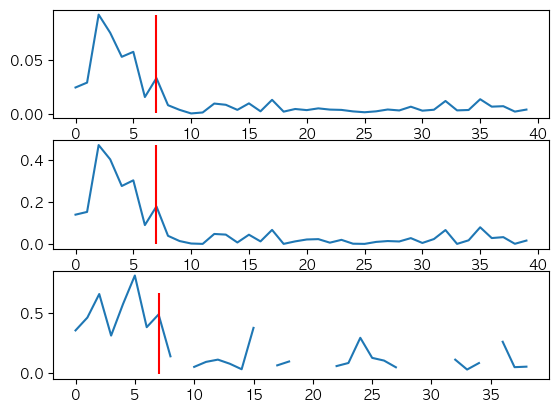

In [ ]:
plt.subplot(311)
beta = beta1
plt.plot(beta)
plt.vlines(7,np.min(beta),np.max(beta),"red")
plt.subplot(312)
beta = beta2
plt.plot(beta)
plt.vlines(7,np.min(beta),np.max(beta),"red")
plt.subplot(313)
beta = beta3
plt.plot(np.sqrt(beta))
plt.vlines(7,np.min(beta),np.max(beta),"red")

In [ ]:
heatmap = pd.DataFrame(sa_mi_heatmap+sa_full_heatmap+sa_partial_heatmap)

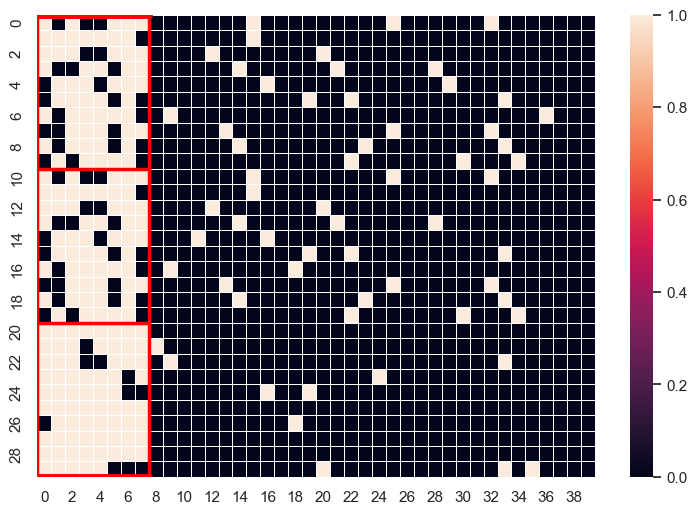

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme()

f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(heatmap,  linewidths=.5, ax=ax)

plt.axvline(number_influentials, 0,3,color="red",linewidth=2.5)
plt.axvline(0, 0, 3,color="red",linewidth=2.5)
plt.axhline(30, 0,number_influentials/40,color="red",linewidth=5)
plt.axhline(20, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(10, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(0, 0,number_influentials/40,color="red",linewidth=5)


In [ ]:
X_mi = X[:,sa_mi_result.astype(bool)]
X_full = X[:,sa_full_result.astype(bool)]
X_partial = X[:,sa_partial_result.astype(bool)]
datasets = [X,X_mi,X_full,X_partial]
Accuracy_list = []
CN_list = []
for i in range(4) :
    dataset = datasets[i]
    Accuracy_list += [bf.get_accuracy(dataset,y,0.9)]
    CN_list += [bf.get_CN(dataset)]
result = pd.DataFrame([Accuracy_list]+[CN_list])
result.index = ["Accuracy","CN"]
result.columns = ["Full","MIC","Corr","Partial Corr"]
result

/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


,Full,MIC,Corr,Partial Corr
Accuracy,0.900000,0.850000,0.850000,0.830000
CN,43.628189,2.892109,2.892109,2.928035


In [11]:
num_test = 2

number_samples = 1000
number_features = 40
number_influentials = 8

covariance_parameter = 50
epsilon = 0

n_features=16
lmbd = 0.01

In [12]:
sa_mi_heatmap = []
sa_full_heatmap = []
sa_partial_heatmap = []
Accuracy_list_total = []
CN_list_total = []

for i in range(num_test):
    beta_coef = np.concatenate([np.random.normal(10,1,number_influentials),np.zeros(number_features-number_influentials)])
    X,y = bf.generate_dependent_sample_logistic(number_samples,number_features,beta_coef,covariance_parameter=covariance_parameter,epsilon=epsilon)
    y_type="binary"
    sa_mi = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="mi")
    sa_mi_result = sa_mi.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_full = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="full")
    sa_full_result = sa_full.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_partial = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="partial")
    sa_partial_result = sa_partial.optimize(X,y,lmbd,reps=10,n_features=n_features)
    
    sa_mi_heatmap += [sa_mi_result.tolist()]
    sa_full_heatmap += [sa_full_result.tolist()]
    sa_partial_heatmap += [sa_partial_result.tolist()]

    X_mi = X[:,sa_mi_result.astype(bool)]
    X_full = X[:,sa_full_result.astype(bool)]
    X_partial = X[:,sa_partial_result.astype(bool)]
    datasets = [X,X_mi,X_full,X_partial]
    Accuracy_list = []
    CN_list = []
    for i in range(4) :
        dataset = datasets[i]
        Accuracy_list += [bf.get_accuracy(dataset,y,0.9)]
        CN_list += [bf.get_CN(dataset)]
    Accuracy_list_total += [Accuracy_list]
    CN_list_total += [CN_list]

/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

In [13]:
heatmap = pd.DataFrame(sa_mi_heatmap+sa_full_heatmap+sa_partial_heatmap)

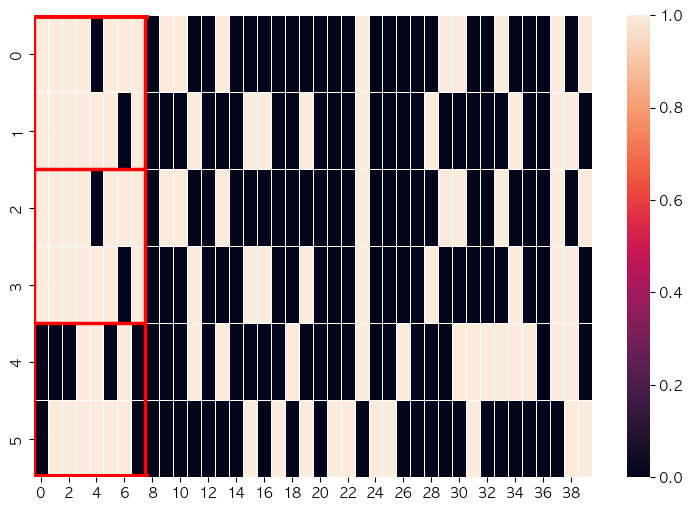

In [54]:
f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(heatmap,  linewidths=.5, ax=ax)
plt.axvline(number_influentials, 0,3,color="red",linewidth=2.5)
plt.axvline(0, 0, 3,color="red",linewidth=2.5)
plt.axhline(num_test*3, 0,number_influentials/40,color="red",linewidth=5)
plt.axhline(num_test*2, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(num_test*1, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(0, 0,number_influentials/40,color="red",linewidth=5)
plt.savefig(path+"/var_heatmap.png")

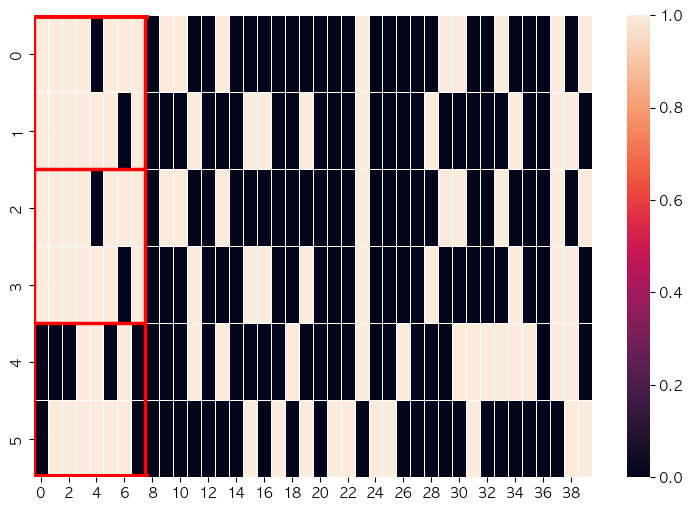

In [55]:
f

In [15]:
target = Accuracy_list_total
Accuracy_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
target = CN_list_total
CN_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
result = pd.DataFrame([Accuracy_result,CN_result])
result.index = ["Accuracy","CN"]
result.columns = ["Full","MIC","Ord R2","Partial R2"]
result


,Full,MIC,Ord R2,Partial R2
Accuracy,0.88(0.03),0.89(0.04),0.88(0.03),0.82(0.0)
CN,111.68(10.14),3.67(0.16),3.67(0.16),3.5(0.83)


In [52]:
path

'./result/simulation_heatmap/test_23y04m27d01:47'

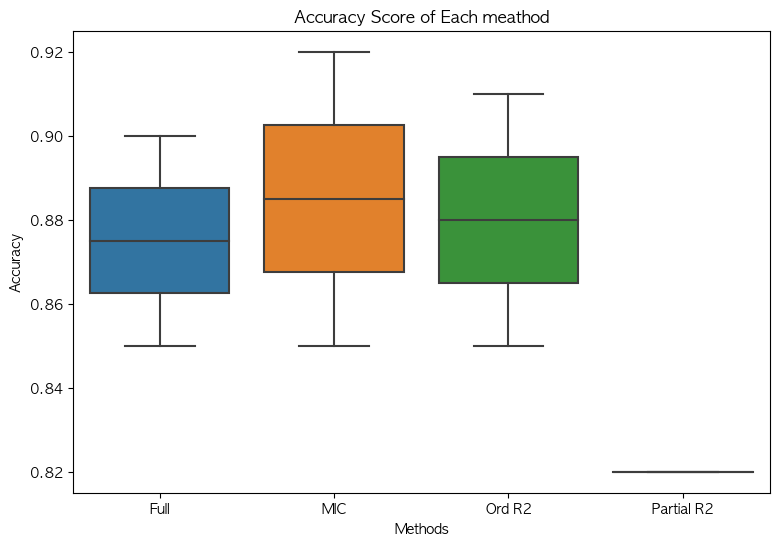

In [57]:
plot_df = pd.DataFrame(np.array([np.array([["Full","MIC","Ord R2","Partial R2"] for i in range(num_test)]).reshape(-1),np.array(Accuracy_list_total).reshape(-1)]).T)
plot_df.columns = ["Methods","Accuracy"]
plot_df.iloc[:,1] = plot_df.iloc[:,1:2].applymap(float)
f2, ax = plt.subplots(figsize=(9, 6))
sns.boxplot(data=plot_df,x="Methods",y="Accuracy")
plt.title("Accuracy Score of Each meathod")
plt.savefig(path+"/acc_figure.png")
plt.show()

In [59]:
f2.savefig(path+"/acc_figure2.png")

In [32]:
total_result1 = np.array([result,Accuracy_list_total,CN_list_total,heatmap])

/var/folders/r7/4kckzfxd78df0ln3wt2tjs180000gn/T/ipykernel_73980/2627799076.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  total_result1 = np.array([result,Accuracy_list_total,CN_list_total,heatmap])


In [24]:
from time import gmtime, strftime
time = strftime("%yy%mm%dd%H:%M", gmtime())


In [25]:
time

'23y04m27d01:47'

In [31]:
parent = "./result/"
child = "simulation_heatmap/test_"+str(time)
path = os.path.join(parent,child)
os.makedirs(path)

In [42]:
acc_result = pd.DataFrame(total_result1[1])
acc_result.columns = ["Full","MIC","Ord R2","Partial R2"]
acc_result.index = ["test_" + str(i) for i in range(num_test)]

In [46]:
cn_result = pd.DataFrame(CN_list_total)
cn_result.columns = ["Full","MIC","Ord R2","Partial R2"]
cn_result.index = ["test_" + str(i) for i in range(num_test)]

In [47]:
result

,Full,MIC,Ord R2,Partial R2
Accuracy,0.88(0.03),0.89(0.04),0.88(0.03),0.82(0.0)
CN,111.68(10.14),3.67(0.16),3.67(0.16),3.5(0.83)


In [48]:
result.to_csv(path+"/result.csv")
acc_result.to_csv(path+"/acc_result.csv")
cn_result.to_csv(path+"/cn_result.csv")
heatmap.to_csv(path + "/heatmap.csv")

In [38]:
pd.DataFrame(total_result1[2])

,0,1,2,3
0,101.544334,3.507893,3.507893,4.322279
1,121.821342,3.827136,3.827136,2.668793


In [ ]:
num_test = 30

number_samples = 1000
number_features = 40
number_influentials = 12

covariance_parameter = 50
epsilon = 0

n_features=16
lmbd = 0.01

In [ ]:
sa_mi_heatmap = []
sa_full_heatmap = []
sa_partial_heatmap = []
Accuracy_list_total = []
CN_list_total = []

for i in range(num_test):
    beta_coef = np.concatenate([np.random.normal(10,1,number_influentials),np.zeros(number_features-number_influentials)])
    X,y = bf.generate_dependent_sample_logistic(number_samples,number_features,beta_coef,covariance_parameter=covariance_parameter,epsilon=epsilon)
    y_type="binary"
    sa_mi = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="mi")
    sa_mi_result = sa_mi.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_full = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="full")
    sa_full_result = sa_full.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_partial = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="partial")
    sa_partial_result = sa_partial.optimize(X,y,lmbd,reps=10,n_features=n_features)
    
    sa_mi_heatmap += [sa_mi_result.tolist()]
    sa_full_heatmap += [sa_full_result.tolist()]
    sa_partial_heatmap += [sa_partial_result.tolist()]

    X_mi = X[:,sa_mi_result.astype(bool)]
    X_full = X[:,sa_full_result.astype(bool)]
    X_partial = X[:,sa_partial_result.astype(bool)]
    datasets = [X,X_mi,X_full,X_partial]
    Accuracy_list = []
    CN_list = []
    for i in range(4) :
        dataset = datasets[i]
        Accuracy_list += [bf.get_accuracy(dataset,y,0.9)]
        CN_list += [bf.get_CN(dataset)]
    Accuracy_list_total += [Accuracy_list]
    CN_list_total += [CN_list]

/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

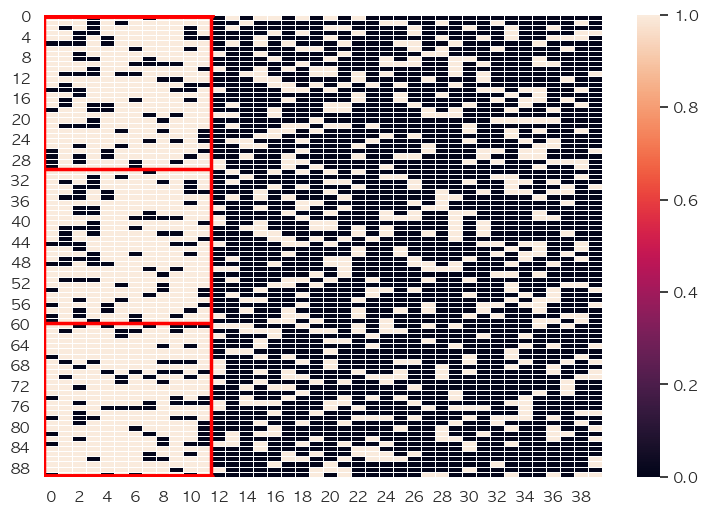

In [ ]:
heatmap = pd.DataFrame(sa_mi_heatmap+sa_full_heatmap+sa_partial_heatmap)
f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(heatmap,  linewidths=.5, ax=ax)
plt.axvline(number_influentials, 0,3,color="red",linewidth=2.5)
plt.axvline(0, 0, 3,color="red",linewidth=2.5)
plt.axhline(num_test*3, 0,number_influentials/40,color="red",linewidth=5)
plt.axhline(num_test*2, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(num_test*1, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(0, 0,number_influentials/40,color="red",linewidth=5)

In [ ]:
target = Accuracy_list_total
Accuracy_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
target = CN_list_total
CN_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
result = pd.DataFrame([Accuracy_result,CN_result])
result.index = ["Accuracy","CN"]
result.columns = ["Full","MIC","Ord R2","Partial R2"]
result

,Full,MIC,Ord R2,Partial R2
Accuracy,0.9(0.03),0.86(0.03),0.86(0.04),0.87(0.04)
CN,79.51(22.48),3.76(0.5),3.74(0.51),3.38(0.42)


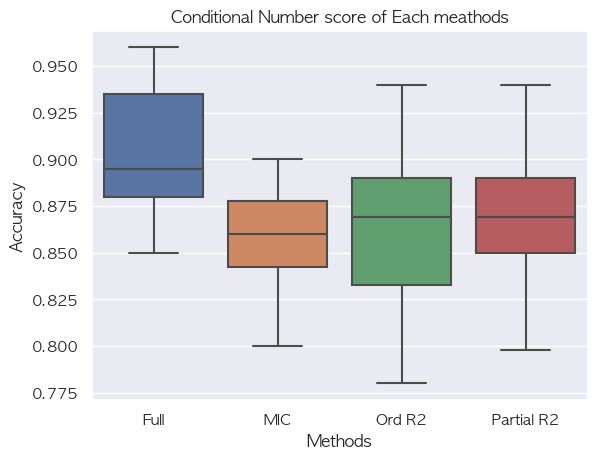

In [ ]:
plot_df = pd.DataFrame(np.array([np.array([["Full","MIC","Ord R2","Partial R2"] for i in range(num_test)]).reshape(-1),np.array(Accuracy_list_total).reshape(-1)]).T)
plot_df.columns = ["Methods","Accuracy"]
plot_df.iloc[:,1] = plot_df.iloc[:,1:2].applymap(float)
sns.boxplot(data=plot_df,x="Methods",y="Accuracy")
plt.title("Conditional Number score of Each meathods")
plt.show()

In [ ]:
total_result2 = np.array([Accuracy_list_total,CN_list_total,heatmap])

/var/folders/r7/4kckzfxd78df0ln3wt2tjs180000gn/T/ipykernel_64938/3286848679.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  total_result2 = np.array([Accuracy_list_total,CN_list_total,heatmap])


In [ ]:
num_test = 30

number_samples = 1000
number_features = 40
number_influentials = 16

covariance_parameter = 50
epsilon = 0

n_features=16
lmbd = 0.01

In [ ]:
sa_mi_heatmap = []
sa_full_heatmap = []
sa_partial_heatmap = []
Accuracy_list_total = []
CN_list_total = []

for i in range(num_test):
    beta_coef = np.concatenate([np.random.normal(10,1,number_influentials),np.zeros(number_features-number_influentials)])
    X,y = bf.generate_dependent_sample_logistic(number_samples,number_features,beta_coef,covariance_parameter=covariance_parameter,epsilon=epsilon)
    y_type="binary"
    sa_mi = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="mi")
    sa_mi_result = sa_mi.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_full = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="full")
    sa_full_result = sa_full.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_partial = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="partial")
    sa_partial_result = sa_partial.optimize(X,y,lmbd,reps=10,n_features=n_features)
    
    sa_mi_heatmap += [sa_mi_result.tolist()]
    sa_full_heatmap += [sa_full_result.tolist()]
    sa_partial_heatmap += [sa_partial_result.tolist()]

    X_mi = X[:,sa_mi_result.astype(bool)]
    X_full = X[:,sa_full_result.astype(bool)]
    X_partial = X[:,sa_partial_result.astype(bool)]
    datasets = [X,X_mi,X_full,X_partial]
    Accuracy_list = []
    CN_list = []
    for i in range(4) :
        dataset = datasets[i]
        Accuracy_list += [bf.get_accuracy(dataset,y,0.9)]
        CN_list += [bf.get_CN(dataset)]
    Accuracy_list_total += [Accuracy_list]
    CN_list_total += [CN_list]

/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

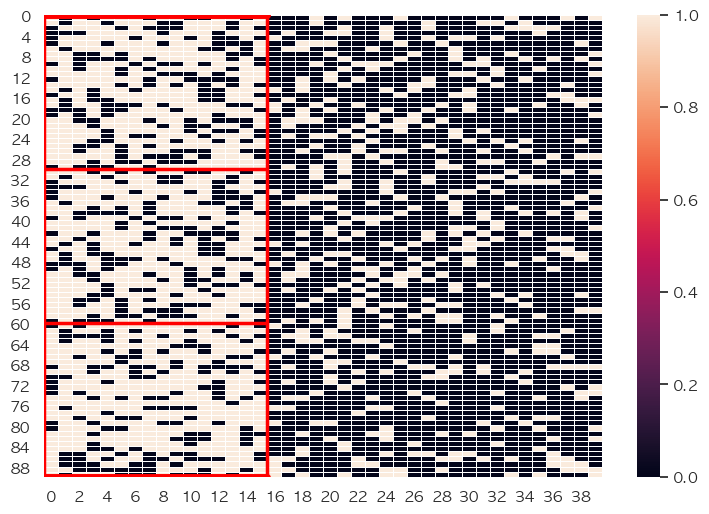

In [ ]:
heatmap = pd.DataFrame(sa_mi_heatmap+sa_full_heatmap+sa_partial_heatmap)
f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(heatmap,  linewidths=.5, ax=ax)
plt.axvline(number_influentials, 0,3,color="red",linewidth=2.5)
plt.axvline(0, 0, 3,color="red",linewidth=2.5)
plt.axhline(num_test*3, 0,number_influentials/40,color="red",linewidth=5)
plt.axhline(num_test*2, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(num_test*1, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(0, 0,number_influentials/40,color="red",linewidth=5)

In [ ]:
[np.sum(np.sum(heatmap.iloc[:,:number_influentials],axis=1)[i*num_test:(i+1)*num_test])/num_test/number_influentials for i in range(3)]

[0.5766666666666667, 0.5783333333333334, 0.6616666666666666]

In [ ]:
target = Accuracy_list_total
Accuracy_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
target = CN_list_total
CN_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
result = pd.DataFrame([Accuracy_result,CN_result])
result.index = ["Accuracy","CN"]
result.columns = ["Full","MIC","Ord R2","Partial R2"]
result

,Full,MIC,Ord R2,Partial R2
Accuracy,0.91(0.03),0.85(0.04),0.85(0.04),0.86(0.04)
CN,89.68(20.18),3.79(0.48),3.8(0.47),3.74(0.64)


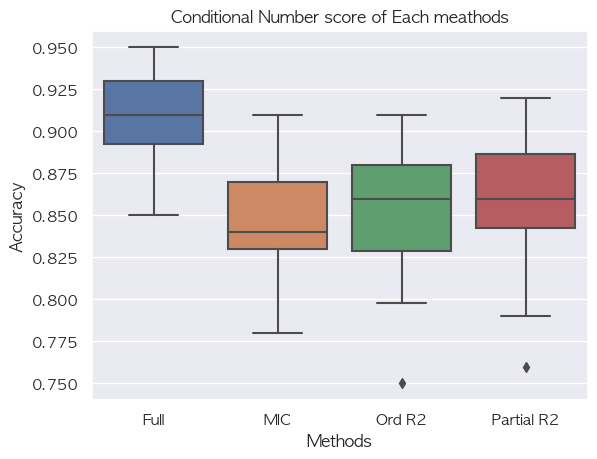

In [ ]:
plot_df = pd.DataFrame(np.array([np.array([["Full","MIC","Ord R2","Partial R2"] for i in range(num_test)]).reshape(-1),np.array(Accuracy_list_total).reshape(-1)]).T)
plot_df.columns = ["Methods","Accuracy"]
plot_df.iloc[:,1] = plot_df.iloc[:,1:2].applymap(float)
sns.boxplot(data=plot_df,x="Methods",y="Accuracy")
plt.title("Conditional Number score of Each meathods")
plt.show()

In [ ]:
total_result3 = np.array([Accuracy_list_total,CN_list_total,heatmap])

/var/folders/r7/4kckzfxd78df0ln3wt2tjs180000gn/T/ipykernel_64938/2791154543.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  total_result3 = np.array([Accuracy_list_total,CN_list_total,heatmap])


In [ ]:
num_test = 30

number_samples = 1000
number_features = 40
number_influentials = 20

covariance_parameter = 50
epsilon = 0

n_features=16
lmbd = 0.01

In [ ]:
sa_mi_heatmap = []
sa_full_heatmap = []
sa_partial_heatmap = []
Accuracy_list_total = []
CN_list_total = []

for i in range(num_test):
    beta_coef = np.concatenate([np.random.normal(10,1,number_influentials),np.zeros(number_features-number_influentials)])
    X,y = bf.generate_dependent_sample_logistic(number_samples,number_features,beta_coef,covariance_parameter=covariance_parameter,epsilon=epsilon)
    y_type="binary"
    sa_mi = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="mi")
    sa_mi_result = sa_mi.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_full = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="full")
    sa_full_result = sa_full.optimize(X,y,lmbd,reps=10,n_features=n_features)
    sa_partial = opt.SimulatedAnnealing("QUBO",y_type=y_type,measure="partial")
    sa_partial_result = sa_partial.optimize(X,y,lmbd,reps=10,n_features=n_features)
    
    sa_mi_heatmap += [sa_mi_result.tolist()]
    sa_full_heatmap += [sa_full_result.tolist()]
    sa_partial_heatmap += [sa_partial_result.tolist()]

    X_mi = X[:,sa_mi_result.astype(bool)]
    X_full = X[:,sa_full_result.astype(bool)]
    X_partial = X[:,sa_partial_result.astype(bool)]
    datasets = [X,X_mi,X_full,X_partial]
    Accuracy_list = []
    CN_list = []
    for i in range(4) :
        dataset = datasets[i]
        Accuracy_list += [bf.get_accuracy(dataset,y,0.9)]
        CN_list += [bf.get_CN(dataset)]
    Accuracy_list_total += [Accuracy_list]
    CN_list_total += [CN_list]

/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/Users/minhyeong-gyu/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_

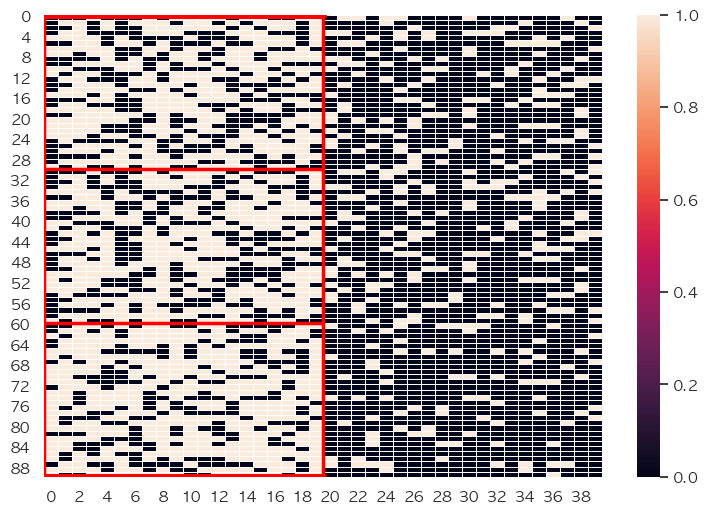

In [ ]:
heatmap = pd.DataFrame(sa_mi_heatmap+sa_full_heatmap+sa_partial_heatmap)
f, ax = plt.subplots(figsize=(9, 6))
sns.heatmap(heatmap,  linewidths=.5, ax=ax)
plt.axvline(number_influentials, 0,3,color="red",linewidth=2.5)
plt.axvline(0, 0, 3,color="red",linewidth=2.5)
plt.axhline(num_test*3, 0,number_influentials/40,color="red",linewidth=5)
plt.axhline(num_test*2, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(num_test*1, 0,number_influentials/40,color="red",linewidth=2.5)
plt.axhline(0, 0,number_influentials/40,color="red",linewidth=5)

In [ ]:
selected_ratio = [np.round(np.sum(np.sum(heatmap.iloc[:,:number_influentials],axis=1)[i*num_test:(i+1)*num_test])/num_test/number_influentials,3) for i in range(3)]
selected_ratio

[0.577, 0.578, 0.662]

In [ ]:
target = Accuracy_list_total
Accuracy_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
target = CN_list_total
CN_result = pd.DataFrame(target).apply(lambda x: str(round(np.mean(x),2)))+"("+pd.DataFrame(target).apply(lambda x: str(round(np.std(x),2)))+")"
result = pd.DataFrame([Accuracy_result,CN_result])
result.index = ["Accuracy","CN"]
result.columns = ["Full","MIC","Ord R2","Partial R2"]
result

,Full,MIC,Ord R2,Partial R2
Accuracy,0.9(0.03),0.86(0.04),0.85(0.04),0.86(0.05)
CN,76.71(23.95),3.59(0.43),3.63(0.43),3.47(0.48)


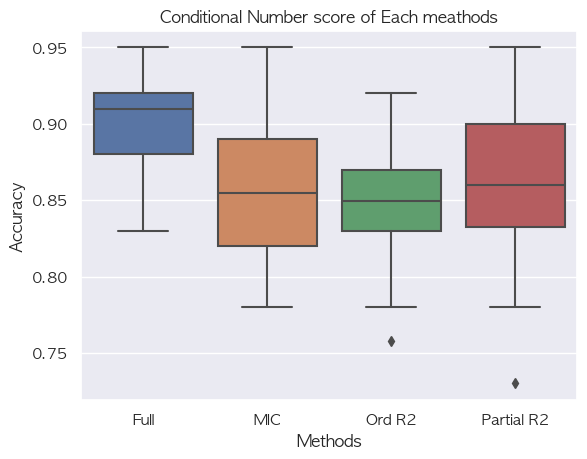

In [ ]:
plot_df = pd.DataFrame(np.array([np.array([["Full","MIC","Ord R2","Partial R2"] for i in range(num_test)]).reshape(-1),np.array(Accuracy_list_total).reshape(-1)]).T)
plot_df.columns = ["Methods","Accuracy"]
plot_df.iloc[:,1] = plot_df.iloc[:,1:2].applymap(float)
sns.boxplot(data=plot_df,x="Methods",y="Accuracy")
plt.title("Conditional Number score of Each meathods")
plt.show()

In [ ]:
total_result4 = np.array([Accuracy_list_total,CN_list_total,heatmap])

/var/folders/r7/4kckzfxd78df0ln3wt2tjs180000gn/T/ipykernel_64938/541376260.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  total_result4 = np.array([Accuracy_list_total,CN_list_total,heatmap])
